## Implement the relue base percentage

In [1]:
import numpy as np
import os
from skimage import measure
import pylab as plt
import openslide as ops
path = '/home/zyx31/DATA_CRLM/CRLM/Results/WR_lev0ps448_stp_128/'


In [8]:

def map_back_region(treg_index,org_size,regions):
    # 0~1 map for the regions 
    tregion = regions[treg_index]
    treg2 = np.zeros(org_size[:2])
    a,b,c,d = tregion.bbox
    treg2[a:c,b:d] = tregion.filled_image
    return treg2

def filter_regions(regions,min_size):
    filtered_regions_index = []
    for tindex, tregion in enumerate(regions):
        if tregion.area > min_size:
            filtered_regions_index.append(tindex)
            
    return filtered_regions_index

def check_region(treg_index,org_size,regions,tumour_ratio=0.02):
    region_areas = [tregion.area for tregion in regions]
    max_index = region_areas.index(max(region_areas))
    
    tmap = map_back_region(treg_index,org_size,regions)
    tmp_re4 = np.copy(tmp_re1)
    tmp_re4[tmap==0] = 12
    
    ## Keep the max region,
    if treg_index == max_index:
        return tmap
    elif np.sum(tmp_re4==3)/np.sum(tmp_re4 !=12) + \
        np.sum(tmp_re4==1)/np.sum(tmp_re4!=12) + \
        np.sum(tmp_re4==5)/np.sum(tmp_re4!=12)  > tumour_ratio:
        return tmap
    else:
        return None

def rule_based_mapbak(regions,org_size,min_size_ratio=0.01,tumour_ratio=0.02):
    ## Tumour rate only for the second biggiest region  
    ## min_size_ratio controls the region for consideration
    min_size = np.prod(org_size[:2])*min_size_ratio
    filtered_regions_index = filter_regions(regions,min_size)
    init_maps = np.zeros(org_size[:2])
    for tindex in filtered_regions_index:
        #print(tindex)
        ttmap = check_region(tindex,org_size,regions,tumour_ratio)
        if ttmap is not None:
            #print(tindex)
            init_maps += ttmap
    return init_maps

/home/zyx31/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


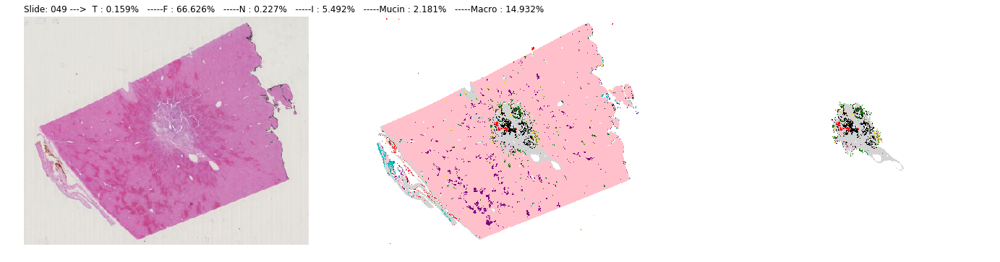

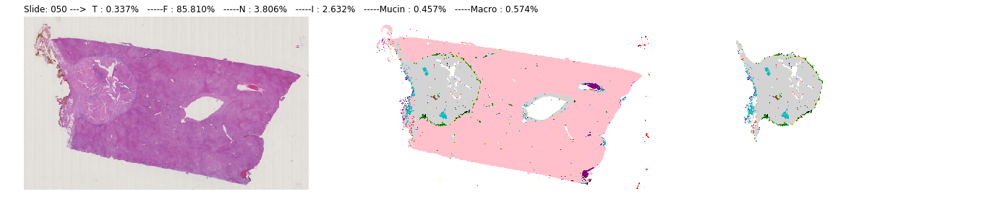

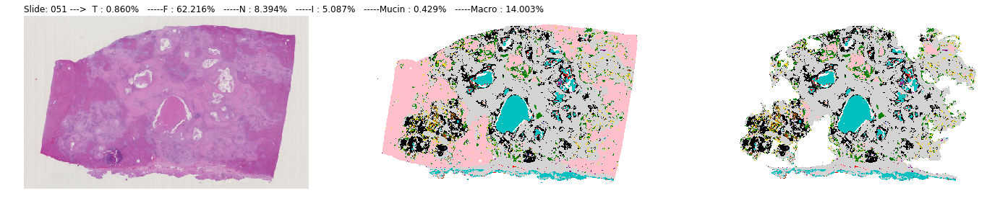

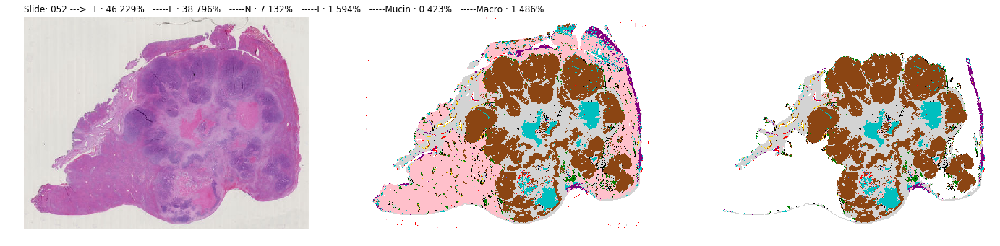

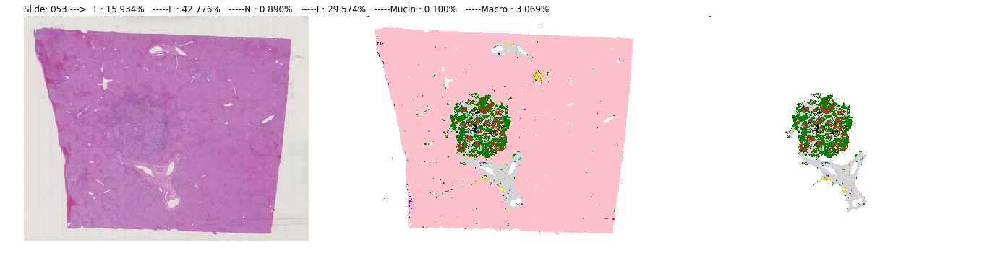

...

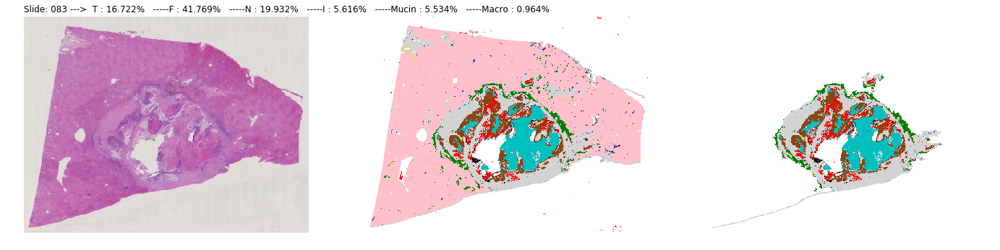

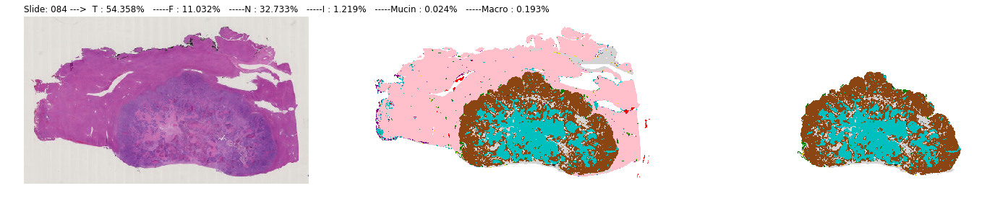

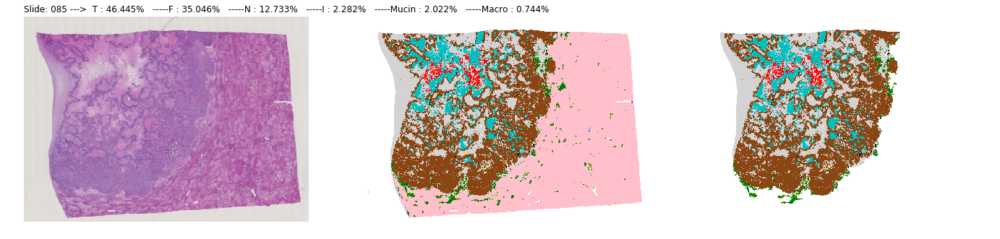

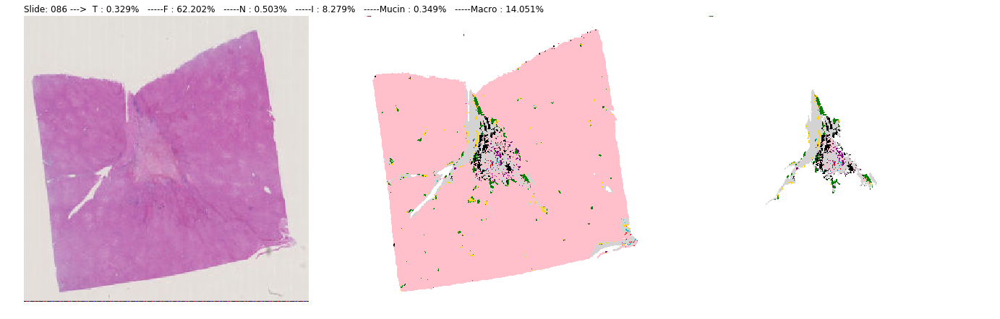

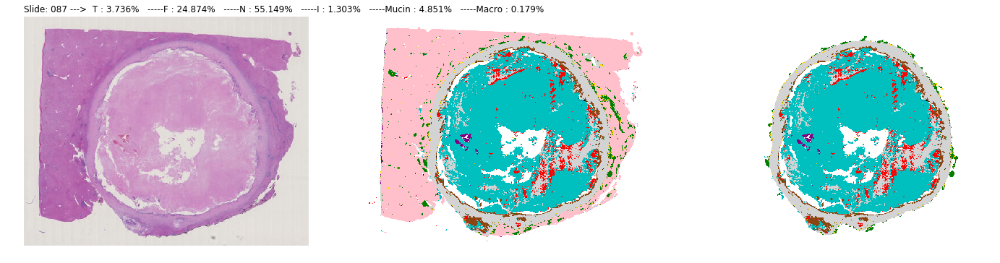

In [11]:
#tmp_index = 75
from matplotlib.colors import ListedColormap

cMap = ListedColormap(['pink','c','lightgrey','saddlebrown','g','r','purple','royalblue','k','white','gold'])
cMap2 = ListedColormap(['pink','c','lightgrey','saddlebrown','g','r','purple','royalblue','k','white','gold','white'])

for tmp_index in range(49,88):


    wsi = ops.OpenSlide('/home/zyx31/DATA_CRLM/CRLM/Original/CRLM_%03d.ndpi'%tmp_index)
    wsi_image = wsi.read_region((0,0),8,wsi.level_dimensions[8])

    tmp_map = np.load(path+'wsi_%02d.npy'%tmp_index)
    #print(tmp_map.shape)

    tmp_re1 = np.argmax(tmp_map,2)
    tmp_mregion = (tmp_re1==9) + (tmp_re1==0)

    regions = measure.regionprops(measure.label(1-tmp_mregion))
    #plt.imshow(rule_based_mapbak(regions,org_size=tmp_map.shape))

    tmp_mregion = (tmp_re1==9) + (tmp_re1==0)
    tmp_re2 = np.copy(tmp_re1)
    
    tmp_re3 = np.copy(tmp_re1) # add 0-10 to matrix
    tmp_re3[:11,0]  = np.arange(0,11)
    
    #-------------main-ops ------------
    treg2 = rule_based_mapbak(regions,org_size=tmp_map.shape,tumour_ratio=0.2)

    tmp_re2[treg2==0] = 12
    
    plt.figure(figsize=[24,8])

    plt.subplot(1,3,1)
    plt.imshow(wsi_image)
    plt.axis('off')
    plt.title("Slide: %03d --->  "%tmp_index+"T : %.3f"%(np.sum(tmp_re2==3)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "F : %.3f"%(np.sum(tmp_re2==2)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "N : %.3f"%(np.sum(tmp_re2==1)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "I : %.3f"%(np.sum(tmp_re2==4)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "Mucin : %.3f"%(np.sum(tmp_re2==5)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "Macro : %.3f"%(np.sum(tmp_re2==8)/np.sum(tmp_re2!=12)*100)+'% ',\
              loc='left')
    
    plt.subplot(1,3,2)
    plt.imshow(tmp_re3.T,cmap=cMap)
    #plt.imshow(tmp_mregion)
    plt.axis('off')
    plt.subplot(1,3,3)
    tmp_re2[:11,0] = [0,1,2,3,4,5,6,7,8,9,10]
    plt.imshow(tmp_re2.T,cmap=cMap2)
    plt.axis('off')


## Test modules, test the 

In [37]:
for tmp_index in range(49,88):
    wsi = ops.OpenSlide('/home/zyx31/DATA_CRLM/CRLM/Original/CRLM_%03d.ndpi'%tmp_index)
    wsi_image = wsi.read_region((0,0),8,wsi.level_dimensions[8])

    tmp_map = np.load(path+'wsi_%02d.npy'%tmp_index)
    #print(tmp_map.shape)

    tmp_re1 = np.argmax(tmp_map,2)
    tmp_mregion = (tmp_re1==9) + (tmp_re1==0)
    
    regions = measure.regionprops(measure.label(1-tmp_mregion))
    print(tmp_index,filter_regions(regions,np.prod(tmp_re1.shape[:2])*0.01))
    

49 [0, 408]
50 [75]
51 [25]
52 [39]
53 [100]
54 [46]
55 [174]
56 [8, 173]
57 [365]
58 [308]
59 [123]
60 [11]
61 [410]
62 [2, 64]
63 [457]
64 [194]
65 [211]
66 [3, 387]
67 [215]
68 [512]
69 [45]
70 [30]
71 [73]
72 [37, 107]
73 [100]
74 [127]
75 [97]
76 [3]
77 [107]
78 [95]
79 [2]
80 [105]
81 [1, 382]
82 [302]
83 [0]
84 [215, 354]
85 [3]
86 [35]
87 [189]


## Initial Virsion 
## Old version -- > debug version

/home/zyx31/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


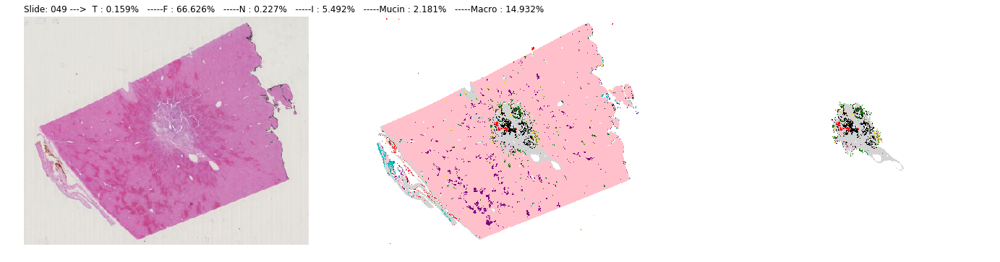

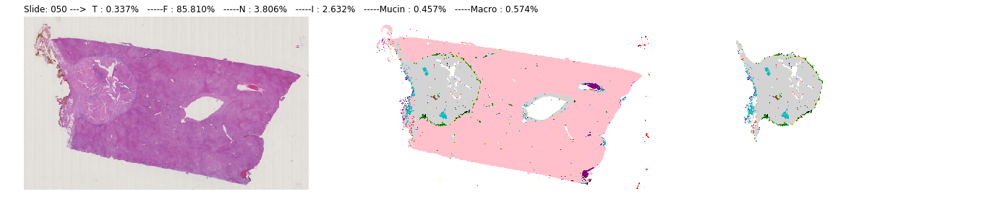

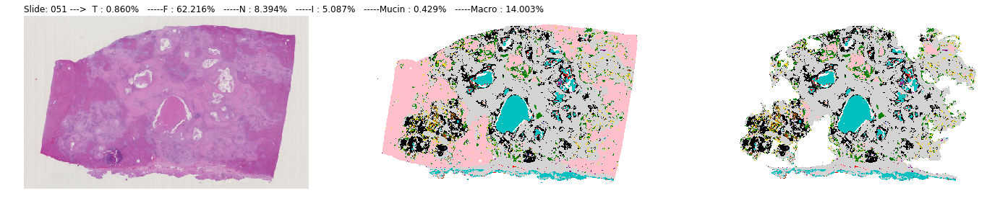

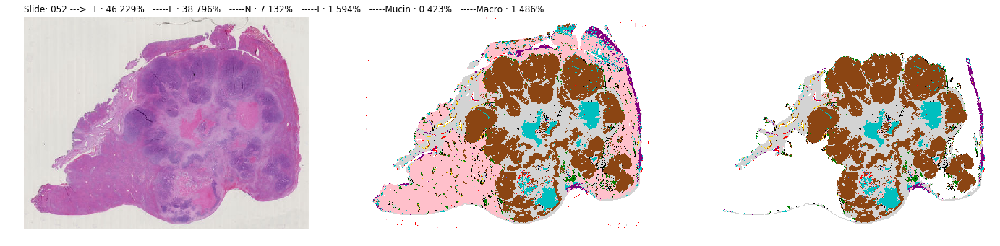

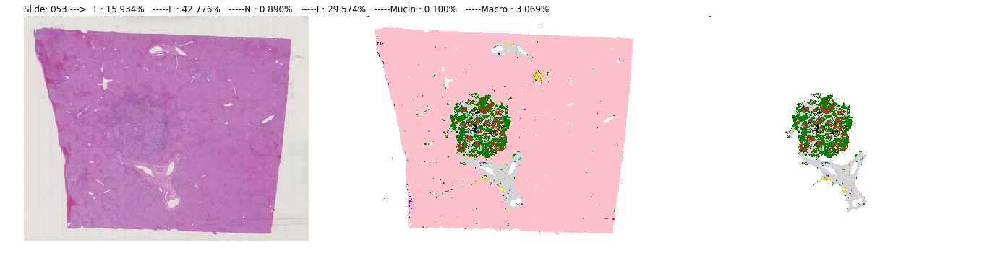

...

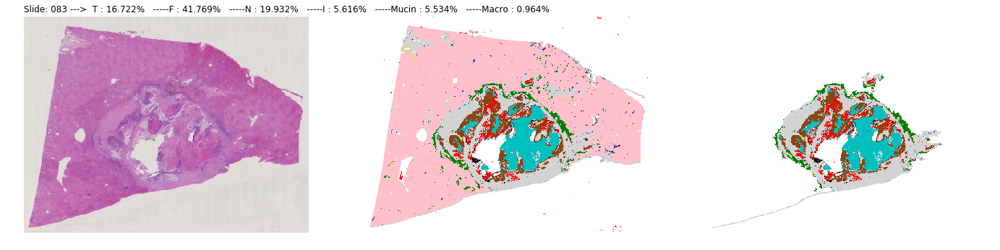

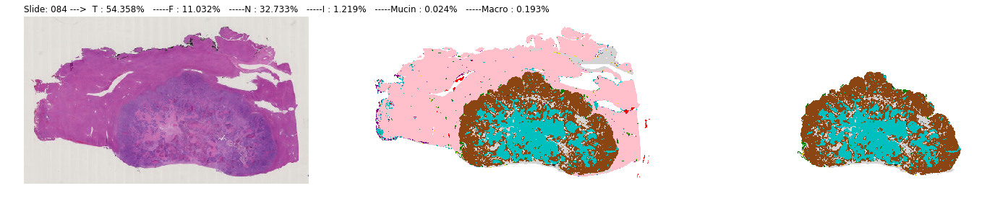

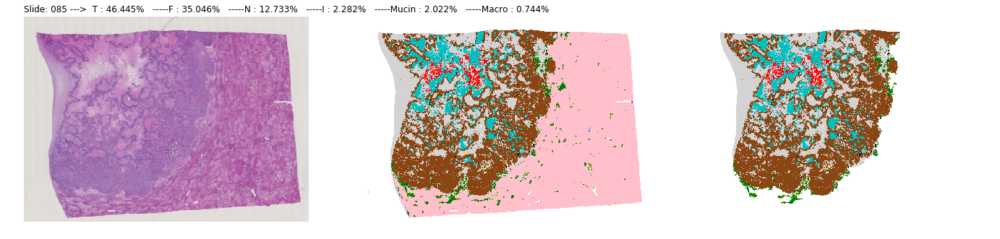

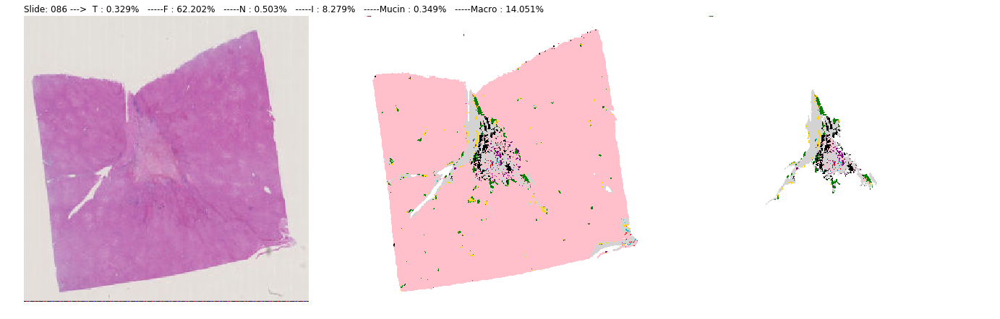

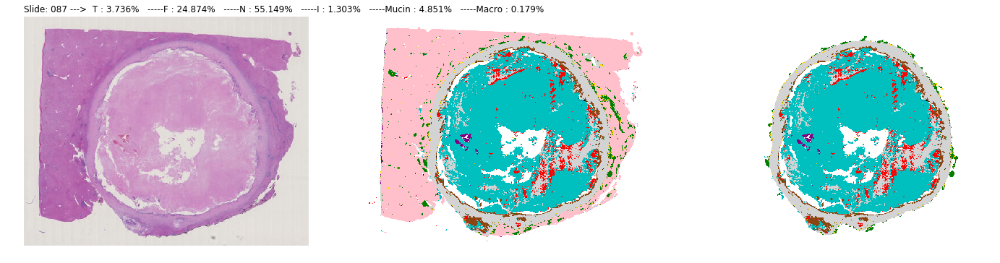

In [24]:
#tmp_index = 75
from matplotlib.colors import ListedColormap

cMap = ListedColormap(['pink','c','lightgrey','saddlebrown','g','r','purple','royalblue','k','white','gold'])
cMap2 = ListedColormap(['pink','c','lightgrey','saddlebrown','g','r','purple','royalblue','k','white','gold','white'])

for tmp_index in range(49,88):
    wsi = ops.OpenSlide('/home/zyx31/DATA_CRLM/CRLM/Original/CRLM_%03d.ndpi'%tmp_index)
    wsi_image = wsi.read_region((0,0),8,wsi.level_dimensions[8])

    tmp_map = np.load(path+'wsi_%02d.npy'%tmp_index)
    #print(tmp_map.shape)

    tmp_re1 = np.argmax(tmp_map,2)
    tmp_mregion = (tmp_re1==9) + (tmp_re1==0)
    tmp_re2 = np.copy(tmp_re1)
    
    tmp_re3 = np.copy(tmp_re1) # add 0-10 to matrix
    tmp_re3[:11,0]  = np.arange(0,11)
    
    regions = measure.regionprops(measure.label(1-tmp_mregion))

    region_areas = [tregion.area for tregion in regions]

    treg2 = map_back_region(region_areas.index(max(region_areas)),tmp_map.shape,regions)

    tmp_re2[treg2==0] = 12
    
    #print('T : ',"%.3f"%(np.sum(tmp_re2==3)/np.sum(tmp_re2!=-2)*100)+'%',end=', ---- || ')
    #print('F : ',"%.3f"%(np.sum(tmp_re2==1)/np.sum(tmp_re2!=-2)*100)+'%',end=', ----  ||  ')
    #print('N : ',"%.3f"%(np.sum(tmp_re2==2)/np.sum(tmp_re2!=-2)*100)+'%',end=', ---- ||  ')
    #print('M : ',"%.3f"%(np.sum(tmp_re2==5)/np.sum(tmp_re2!=-2)*100)+'%')
    
    plt.figure(figsize=[24,8])

    plt.subplot(1,3,1)
    plt.imshow(wsi_image)
    plt.axis('off')
    plt.title("Slide: %03d --->  "%tmp_index+"T : %.3f"%(np.sum(tmp_re2==3)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "F : %.3f"%(np.sum(tmp_re2==2)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "N : %.3f"%(np.sum(tmp_re2==1)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "I : %.3f"%(np.sum(tmp_re2==4)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "Mucin : %.3f"%(np.sum(tmp_re2==5)/np.sum(tmp_re2!=12)*100)+'%   -----'+\
             "Macro : %.3f"%(np.sum(tmp_re2==8)/np.sum(tmp_re2!=12)*100)+'% ',\
              loc='left')
    
    plt.subplot(1,3,2)
    plt.imshow(tmp_re3.T,cmap=cMap)
    #plt.imshow(tmp_mregion)
    plt.axis('off')
#     plt.subplot(1,3,3)
#     plt.imshow(treg2.T)
#     plt.axis('off')
    plt.subplot(1,3,3)
    
    
    tmp_re2[:11,0] = [0,1,2,3,4,5,6,7,8,9,10]
    plt.imshow(tmp_re2.T,cmap=cMap2)
    plt.axis('off')
